# Building Recommender Systems with Spotify Data

## Import Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import spotipy
import datapane as dp
import chart_studio.plotly as py
import chart_studio
import os
username = 'vedant.sp'
api_key = 'HHXf76xO17cxcm4eMBDz'
chart_studio.tools.set_credentials_file(username=username, api_key=api_key)
plt.rcParams.update({'font.size': 22})
%matplotlib inline

## Reading the Data

In [2]:
spotify_data = pd.read_csv('./data/data.csv.zip')
genre_data = pd.read_csv('./data/data_by_genres.csv')
data_by_year = pd.read_csv('./data/data_by_year.csv')
spotify_data.head(10)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665
5,0.1960,1921,0.579,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.697,395076,0.346,0,4pyw9DVHGStUre4J6hPngr,0.168000,2,0.130,-12.506,1,Gati Mardika,6,1921,0.0700,119.824
6,0.4060,1921,0.996,['John McCormack'],0.518,159507,0.203,0,5uNZnElqOS3W4fRmRYPk4T,0.000000,0,0.115,-10.589,1,The Wearing of the Green,4,1921,0.0615,66.221
7,0.0731,1921,0.993,['Sergei Rachmaninoff'],0.389,218773,0.088,0,02GDntOXexBFUvSgaXLPkd,0.527000,1,0.363,-21.091,0,"Morceaux de fantaisie, Op. 3: No. 2, Prélude i...",2,1921,0.0456,92.867
8,0.7210,1921,0.996,['Ignacio Corsini'],0.485,161520,0.130,0,05xDjWH9ub67nJJk82yfGf,0.151000,5,0.104,-21.508,0,La Mañanita - Remasterizado,0,1921-03-20,0.0483,64.678
9,0.7710,1921,0.982,['Fortugé'],0.684,196560,0.257,0,08zfJvRLp7pjAb94MA9JmF,0.000000,8,0.504,-16.415,1,Il Etait Syndiqué,0,1921,0.3990,109.378


In [3]:
spotify_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [4]:
genre_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [5]:
data_by_year.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


## Exploratory Data Analysis

c:\python\python38\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


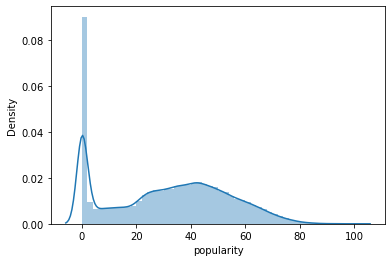

In [6]:
sns.distplot(spotify_data['popularity'])

### Music Over Time

In [7]:
def get_decade(year):
    
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    
    return decade

spotify_data['decade'] = spotify_data['year'].apply(get_decade)

c:\python\python38\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


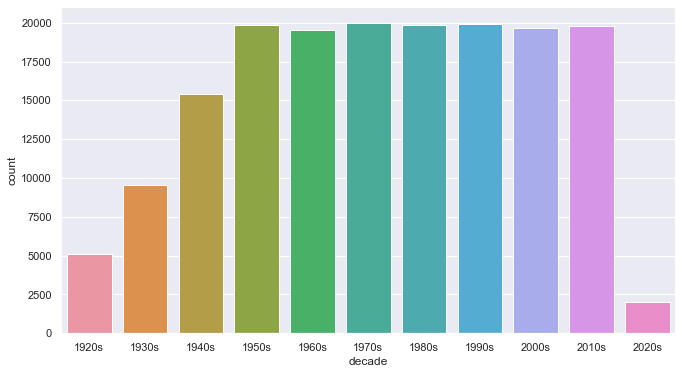

In [8]:
sns.set(rc={'figure.figsize':(11 ,6)})
sns.countplot(spotify_data['decade'])

In [9]:
import plotly.express as px 

sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(data_by_year, x='year', y=sound_features)

fig.show()


report = dp.Report(dp.Plot(fig) ) #Create a report
# report.publish(name='music_over_time', open=True, visibility='PUBLIC') #Publish the report
report.save(path="Plot1.html")

Report saved to ./Plot1.html. To upload and share your report, create a free Datapane account by running `!datapane signup`.

In [10]:
fig = px.line(data_by_year, x='year', y='tempo')

fig.show()


report = dp.Report(dp.Plot(fig) ) #Create a report
# report.publish(name='music_tempo_over_time', open=True, visibility='PUBLIC') #Publish the report
report.save(path="Plot2.html")

Report saved to ./Plot2.html. To upload and share your report, create a free Datapane account by running `!datapane signup`.

### Characteristics of Different Genres

In [11]:
top10_genres = genre_data.nlargest(10, 'popularity')

In [12]:
fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')

fig.show()


report = dp.Report(dp.Plot(fig) ) #Create a report
# report.publish(name='sound_of_different_genres', open=True, visibility='PUBLIC') #Publish the report
report.save(path="Plot3.html")

Report saved to ./Plot3.html. To upload and share your report, create a free Datapane account by running `!datapane signup`.

## Clustering Genres

In [13]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10, n_jobs=-1))])

X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

c:\python\python38\lib\site-packages\sklearn\cluster\_kmeans.py:792: FutureWarning:

'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).



In [14]:
from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=2))])
genre_embedding = tsne_pipeline.fit_transform(X)

projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.015s...
[t-SNE] Computed neighbors for 2973 samples in 0.417s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] Computed conditional probabilities in 0.114s
[t-SNE] Iteration 50: error = 81.9153976, gradient norm = 0.0209763 (50 iterations in 1.214s)
[t-SNE] Iteration 100: error = 76.3590698, gradient norm = 0.0040745 (50 iterations in 0.852s)
[t-SNE] Iteration 150: error = 76.1740189, gradient norm = 0.0012026 (50 iterations in 0.867s)
[t-SNE] Iteration 200: error = 76.1253433, gradient norm = 0.0004152 (50 iterations in 0.947s)
[t-SNE] Iteration 250: error = 76.1092377, gradient norm = 0.0002985 (50 iterations in 0.818s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.109238
[t-SNE] Iteration 300: erro

In [15]:
import plotly.express as px

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()


report = dp.Report(dp.Plot(fig) ) #Create a report
# report.publish(name='clustering_genres', open=True, visibility='PUBLIC') #Publish the report
report.save(path="Plot4.html")

Report saved to ./Plot4.html. To upload and share your report, create a free Datapane account by running `!datapane signup`.

## Clustering Songs

In [16]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=2, n_jobs=4))], verbose=True)
X = spotify_data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)

[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.2s


c:\python\python38\lib\site-packages\sklearn\cluster\_kmeans.py:792: FutureWarning:

'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).



Initialization complete
Iteration 0, inertia 1551354.7188896353
Iteration 1, inertia 1158180.2303208648
Iteration 2, inertia 1110981.6885392088
Iteration 3, inertia 1090574.8518568694
Iteration 4, inertia 1080297.5050525046
Iteration 5, inertia 1075353.5781276736
Iteration 6, inertia 1071928.2813997855
Iteration 7, inertia 1068908.00804475
Iteration 8, inertia 1065924.5225683374
Iteration 9, inertia 1063119.694676474
Iteration 10, inertia 1060868.3491613022
Iteration 11, inertia 1059378.0142897048
Iteration 12, inertia 1058426.4099132516
Iteration 13, inertia 1057821.1378903058
Iteration 14, inertia 1057337.721611425
Iteration 15, inertia 1056796.4832155474
Iteration 16, inertia 1056177.2303916584
Iteration 17, inertia 1055443.262788695
Iteration 18, inertia 1054670.8016255114
Iteration 19, inertia 1054024.918041842
Iteration 20, inertia 1053591.490652607
Iteration 21, inertia 1053314.12044948
Iteration 22, inertia 1053129.692530638
Iteration 23, inertia 1053025.883197022
Iteration 24,

Iteration 4, inertia 1088301.3675575398
Iteration 5, inertia 1082926.507201417
Iteration 6, inertia 1078934.8969157152
Iteration 7, inertia 1075701.6132750297
Iteration 8, inertia 1073566.624387185
Iteration 9, inertia 1072343.813644343
Iteration 10, inertia 1071531.6989616991
Iteration 11, inertia 1070824.7598354402
Iteration 12, inertia 1070131.2226354438
Iteration 13, inertia 1069363.4573708437
Iteration 14, inertia 1068506.4695947217
Iteration 15, inertia 1067645.7350075557
Iteration 16, inertia 1066802.7081970559
Iteration 17, inertia 1066011.5574366762
Iteration 18, inertia 1065216.6241254457
Iteration 19, inertia 1064360.6691700635
Iteration 20, inertia 1063389.296573088
Iteration 21, inertia 1062408.0021478967
Iteration 22, inertia 1061637.7923746416
Iteration 23, inertia 1061061.954926908
Iteration 24, inertia 1060651.4151807183
Iteration 25, inertia 1060385.796010703
Iteration 26, inertia 1060213.3526099976
Iteration 27, inertia 1060100.1747664427
Iteration 28, inertia 106001

Iteration 105, inertia 1071186.6601666624
Iteration 106, inertia 1071184.2544836667
Converged at iteration 106: center shift 9.993353835693513e-05 within tolerance 0.00010000000000000789.
Initialization complete
Iteration 0, inertia 1577995.112994856
Iteration 1, inertia 1200578.7238447447
Iteration 2, inertia 1158521.3563007186
Iteration 3, inertia 1126579.9915222072
Iteration 4, inertia 1103233.1046753468
Iteration 5, inertia 1095234.9251883004
Iteration 6, inertia 1091937.2714028168
Iteration 7, inertia 1089939.632948082
Iteration 8, inertia 1088381.7122864644
Iteration 9, inertia 1086829.4918128715
Iteration 10, inertia 1085067.400825449
Iteration 11, inertia 1082928.9144635696
Iteration 12, inertia 1080734.4348279017
Iteration 13, inertia 1078781.4772834722
Iteration 14, inertia 1077141.8586240786
Iteration 15, inertia 1075807.4378941732
Iteration 16, inertia 1074671.0414883434
Iteration 17, inertia 1073759.7406716403
Iteration 18, inertia 1073106.1421655966
Iteration 19, inertia 

Pipeline(steps=[('scaler', StandardScaler()),
                ('kmeans', KMeans(n_clusters=20, n_jobs=4, verbose=2))],
         verbose=True)

In [17]:
song_cluster_labels = song_cluster_pipeline.predict(X)

In [18]:
spotify_data['cluster_label'] = song_cluster_labels

In [19]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)

projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = spotify_data['name']
projection['cluster'] = spotify_data['cluster_label']

In [20]:
import plotly.express as px

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()


report = dp.Report(dp.Plot(fig) ) #Create a report
# report.publish(name='clustering_songs', open=True, visibility='PUBLIC') #Publish the report
report.save(path="Plot5.html")

Report saved to ./Plot5.html. To upload and share your report, create a free Datapane account by running `!datapane signup`.

## Building a Content-Based Recommender System

In [21]:
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id='16d78ecc582d4dcf961755ae89754a92',
                                                           client_secret='6177261916924ba58743de939a1cb90e'))


def find_song(name, year):
    
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,
                                                       year), limit=1)
    if results['tracks']['items'] == []:
        return None
    
    results = results['tracks']['items'][0]

    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]
    
    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]
    
    for key, value in audio_features.items():
        song_data[key] = value
    
    return pd.DataFrame(song_data)
    

In [22]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']

def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)

def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict
        

def recommend_songs( song_list, spotify_data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

In [28]:
recommend_songs([{'name':'Memories','year':2019}],  spotify_data)

[{'name': 'This City', 'year': 2019, 'artists': "['Sam Fischer']"},
 {'name': 'One', 'year': 2019, 'artists': "['Lewis Capaldi']"},
 {'name': 'changes', 'year': 2018, 'artists': "['XXXTENTACION']"},
 {'name': 'Dancing With Your Ghost',
  'year': 2019,
  'artists': "['Sasha Sloan']"},
 {'name': 'Sonora Y Sus Ojos Negros',
  'year': 1995,
  'artists': "['Miguel Y Miguel']"},
 {'name': 'Tee Shirt - Soundtrack Version',
  'year': 2014,
  'artists': "['Birdy']"},
 {'name': 'I Gotta Be', 'year': 1997, 'artists': "['Jagged Edge']"},
 {'name': 'Bachata Rosa',
  'year': 2013,
  'artists': "['Natalie Cole', 'Juan Luis Guerra 4.40']"},
 {'name': 'The A Team', 'year': 2011, 'artists': "['Ed Sheeran']"}]

In [32]:
recommend_songs([{'name': 'Symphony','year':2012 ,}], spotify_data)

[{'name': 'Dragons', 'year': 2008, 'artists': "['Caravan Palace']"},
 {'name': 'Blood Money', 'year': 2005, 'artists': "['10 Ft. Ganja Plant']"},
 {'name': 'A Fool Moon Night', 'year': 2010, 'artists': "['THE KOXX']"},
 {'name': 'Thinking Of You', 'year': 2000, 'artists': "['A Perfect Circle']"},
 {'name': 'Tribulations', 'year': 2005, 'artists': "['LCD Soundsystem']"},
 {'name': "I'm Waiting For You",
  'year': 2009,
  'artists': "['Jackiem Joyner']"},
 {'name': 'Bananas and Blow', 'year': 2000, 'artists': "['Ween']"},
 {'name': 'Transatlantic', 'year': 2002, 'artists': "['Quantic']"},
 {'name': 'Sexual (Li Da Di) - Thunderpuss Remix',
  'year': 1999,
  'artists': "['Amber', 'Thunderpuss']"},
 {'name': 'Eurodancer', 'year': 2009, 'artists': "['Mangoo']"}]

In [33]:
recommend_songs([{'name': 'Baby','year':2010},{'name': 'Dragons', 'year': 2008}], spotify_data)

[{'name': 'Soy una Gargola',
  'year': 2006,
  'artists': "['Alex Gargolas', 'Randy']"},
 {'name': 'King Without a Crown', 'year': 2006, 'artists': "['Matisyahu']"},
 {'name': 'I Just Wanna Shine',
  'year': 2019,
  'artists': "['Fitz and The Tantrums']"},
 {'name': 'One More Night', 'year': 2012, 'artists': "['Maroon 5']"},
 {'name': 'Blame It on the Rain',
  'year': 2011,
  'artists': "['Milli Vanilli']"},
 {'name': 'Unity', 'year': 2015, 'artists': "['TheFatRat']"},
 {'name': 'Misery', 'year': 2010, 'artists': "['Maroon 5']"},
 {'name': 'Frontline', 'year': 2004, 'artists': "['Pillar']"},
 {'name': 'Monster',
  'year': 2010,
  'artists': "['Michael Jackson', '50 Cent']"},
 {'name': 'Stutter', 'year': 2012, 'artists': "['Marianas Trench']"}]